# Chossing a model and creating a training function
Some alternatives are:
> #### 1. GAN, 
>> similar structure as the tensorflow Ganrec
> #### 2. Unet,
>> output channel of 2 and then propagation, then mean square error
> #### 3. Gan+Unet
>> the output of <b>2</b> will be propagated and input to a descriminator
> #### 4. Transformers
>> flattening and creating a 32x32 or 64x64 sized shapes that will then be inverse propagated, the energy, distance, and pixelsize information from which the phase and attenuation are retrieved. This is then followed by forward propagation and one of the three methods above will continue


In [ ]:
from ganrec_dataloader import * 
from utils import *   
energy = 11
z = 7.8880960e-2 
pv = 1.04735263e-7 * 4
iter_num = 700

info = {
    'path': "/asap3/petra3/gpfs/p05/2018/data/11005102/processed/nano_2029_spider_hair/flat_field_corr/",
    'images': None,
    'idx': list(np.arange(0, 900, 100)),
    'energy_kev': 18.0,
    'detector_pixel_size': 2.57 * 1e-6,
    'distance_sample_detector': 0.15,
    'pad': 4,
    'iter_num': 100,
    'init_model': False,
    'transform_type': 'brightness',
    'transform_factor': 0.5,
    'file_type': 'tiff',
}
args.update(info)
dataloader = Ganrec_Dataloader(**args)
# fig = dataloader.visualize(tranformed=True, show_or_plot='show')

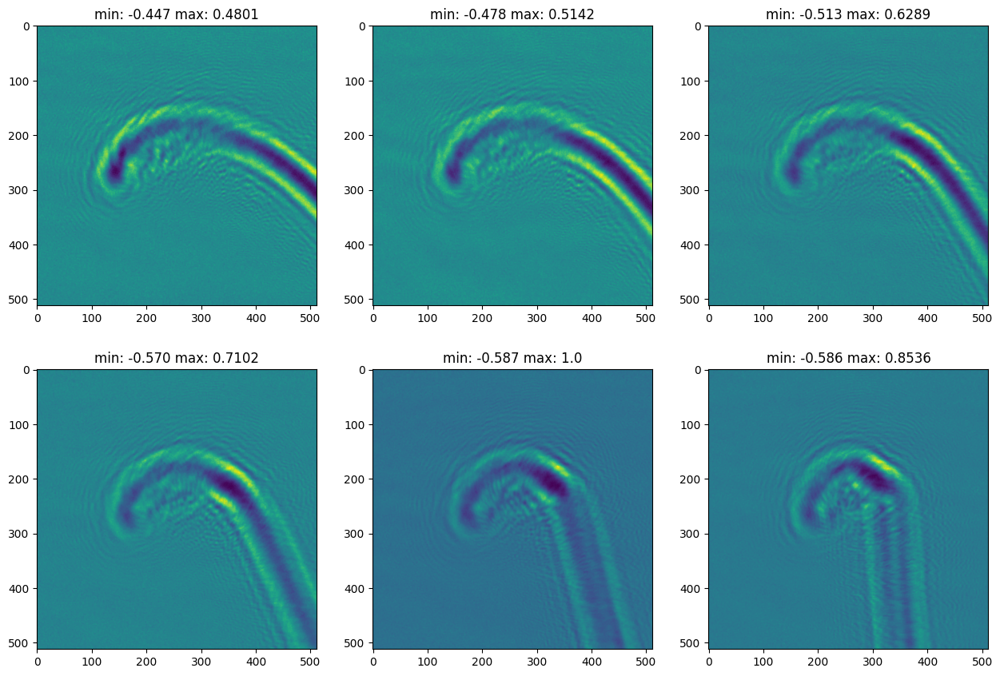

In [2]:
energy = 11
z = 7.8880960e-2
pv = 1.04735263e-7
iter_num = 700
fname_data = 'data/gan_phase/data_spider.tif'

info = {
    'path': None,
    'images': io.imread(fname_data),
    'idx': list(np.arange(0, 70, 10)),
    'energy_kev': energy,
    'detector_pixel_size': pv,
    'distance_sample_detector': z,
    'pad': 1,
    'alpha': 1e-8,
    'iter_num': 100,
    'init_model': False,
    'output_num': 2,
    'transform_type': 'normalize',
    'transform_factor': 0.5,
    'file_type': 'tif',
}

args.update(info)
dataloader = Ganrec_Dataloader(**args)
fig = dataloader.visualize(tranformed=True, show_or_plot='show')

# developing GANREC


In [54]:
import torch
import torch.nn as nn
import torch.nn.init as init

def initializer(m):
        if type(m) == nn.Conv2d:
            init.xavier_uniform_(m.weight)
            if m.bias is not None:
                init.zeros_(m.bias)
                
def discriminator_loss(real_output, fake_output):
    real_loss = torch.mean(torch.nn.BCEWithLogitsLoss()(real_output, torch.ones_like(real_output)))
    fake_loss = torch.mean(torch.nn.BCEWithLogitsLoss()(fake_output, torch.zeros_like(fake_output)))
    total_loss = real_loss + fake_loss
    return total_loss

def generator_loss(fake_output, img_output, pred, l1_ratio = 10):
    #with autograd
    return torch.mean(torch.nn.BCEWithLogitsLoss()(fake_output, torch.ones_like(fake_output))) + \
              l1_ratio * torch.mean(torch.abs(img_output - pred))

def dense_layer(in_features= 128, out_features = 128, dropout = 0.25, apply_batchnorm=True, transpose = False):
    initializer = torch.nn.init.xavier_uniform_(torch.empty(out_features, in_features))
    if apply_batchnorm:
        result = nn.Sequential(
            nn.Linear(in_features, out_features),
            nn.BatchNorm1d(out_features),
            nn.LeakyReLU(),
            nn.Dropout(dropout),
        )
    else:
        result = nn.Sequential(
            nn.Linear(in_features, out_features),
            nn.LeakyReLU(),
            nn.Dropout(dropout),
        )

    if transpose:
        result = nn.Sequential(
            nn.Linear(in_features, out_features),
            Transpose(),
            nn.BatchNorm1d(out_features),
            nn.LeakyReLU(),
            nn.Dropout(dropout),
        )
    return result

def conv2d_layer(in_channels, out_channels, kernel_size, stride, apply_batchnorm=True, normal_init = True):
    def initializer(m):
        if type(m) == nn.Conv2d:
            init.xavier_uniform_(m.weight)
            if m.bias is not None:
                init.zeros_(m.bias)
    if apply_batchnorm:
        result = nn.Sequential(
            nn.Conv2d(in_channels,
                out_channels, 
                kernel_size, 
                stride=stride, 
                padding_mode='zeros',
                bias=False),
            nn.BatchNorm2d(num_features=out_channels),
            nn.LeakyReLU())
    else:
        result = nn.Sequential(
            nn.Conv2d(in_channels,
                out_channels, 
                kernel_size, 
                stride=stride, 
                padding_mode='zeros',
                bias=False),
            nn.LeakyReLU())
    if normal_init:
        result.apply(initializer)
    return result

def deconv2d_layer(in_channels, out_channels, kernel_size, stride, apply_batchnorm=True, normal_init = True):
    def initializer(m):
        if type(m) == nn.Conv2d:
            init.xavier_uniform_(m.weight)
            if m.bias is not None:
                init.zeros_(m.bias)
    if apply_batchnorm:
        result = nn.Sequential(
            nn.ConvTranspose2d(in_channels,
                out_channels,
                kernel_size,
                stride=stride, 
                padding_mode='zeros',
                bias=False),
            nn.BatchNorm2d(num_features=out_channels),
            nn.LeakyReLU())
        
    else:
        result = nn.Sequential(
            nn.ConvTranspose2d(in_channels,
                out_channels,
                kernel_size,
                stride=stride, 
                padding_mode='zeros',
                bias=False),
            nn.LeakyReLU())
    if normal_init:
        result.apply(initializer)
    return result

def tensor_to_np(tensor):
    if type(tensor) is list:
        if len(tensor[0].shape) <= 2:
            try:
                return [t.detach().cpu().numpy() for t in tensor]
            except:
                return [t.numpy()(t) for t in tensor]
        elif len(tensor[0].shape) == 3:
            try:
                return [t.detach().cpu().numpy()[0,:,:] for t in tensor]
            except:
                return [t.numpy()[0,:,:] for t in tensor]
        else:
            try:
                return [t.detach().cpu().numpy()[0,0,:,:] for t in tensor]
            except:
                return [t.numpy()[0,0,:,:] for t in tensor]
    else:
        if len(tensor.shape) <= 2:
            try:
                return tensor.detach().cpu().numpy()
            except:
                return tensor.numpy()
        elif len(tensor.shape) == 3:
            try:
                return tensor.detach().cpu().numpy()[0,:,:]
            except:
                return tensor.numpy()[0,:,:]
        else:
            try:
                return tensor.detach().cpu().numpy()[0,0,:,:]
            except:
                return tensor.numpy()[0,0,:,:]

def to_device(x, device):
    if device is None:
        device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
    try:
        return x.to(device)
    except:
        return torch_reshape(x).to(device)


class Reshape(nn.Module):
    def __init__(self, shape):
        super(Reshape, self).__init__()
        self.shape = shape

    def forward(self, x):
        return x.view(self.shape)
    
class Transpose(nn.Module):
    def __init__(self):
        super(Transpose, self).__init__()

    def forward(self, x):
        return x.view(-1, 1)
  
class Print_module(nn.Module):
    def __init__(self, word = ''):
        super(Print_module, self).__init__()
        self.word = word
    def forward(self, x):
        print(self.word, x.shape)
        return x
    
class make_gen(nn.Module):
    def __init__(self, nfx, nfy, conv_num, conv_size, dropout, output_num, fresnel_factor, device = None, **kwargs):
        for key, value in kwargs.items():
            setattr(self, key, value)
        self.fresnel_factor = fresnel_factor
        self.device = device
        self.nfx = nfx
        self.nfy = nfy
        self.conv_num = conv_num
        self.conv_size = conv_size
        self.dropout = dropout
        self.output_num = output_num
        self.units = 128
        self.fc_size = nfx * nfy
        fc_stack = nn.ModuleList([
            dense_layer(in_features=self.units, out_features=self.units, dropout=dropout),
                dense_layer(in_features=self.units, out_features=self.units, dropout=dropout),
                dense_layer(in_features=self.units, out_features=self.units, dropout=dropout),
                dense_layer(in_features=self.units, out_features=self.units, dropout=dropout),
            ])
        conv_stack = nn.ModuleList([
            conv2d_layer(in_channels=1, out_channels=conv_num, kernel_size=conv_size+2, stride=1),
            conv2d_layer(in_channels=conv_num, out_channels=conv_num, kernel_size=conv_size, stride=1),
            conv2d_layer(in_channels=conv_num, out_channels=conv_num, kernel_size=conv_size, stride=1),
            conv2d_layer(in_channels=conv_num, out_channels=conv_num, kernel_size=conv_size, stride=1),
            ])
        dconv_stack = nn.ModuleList([
            deconv2d_layer(in_channels=conv_num, out_channels=conv_num, kernel_size=conv_size, stride=1),
            deconv2d_layer(in_channels=conv_num, out_channels=conv_num, kernel_size=conv_size+2, stride=1),
            deconv2d_layer(in_channels=conv_num, out_channels=conv_num, kernel_size=conv_size+2, stride=1),
            deconv2d_layer(in_channels=conv_num, out_channels=output_num, kernel_size=conv_size, stride=1),
            ])
        last_1 = conv2d_layer(in_channels=conv_num, out_channels=output_num, kernel_size=conv_size, stride=1)
        last = conv2d_layer(in_channels=output_num, out_channels=output_num, kernel_size=conv_size, stride=1)
        

        self.model = to_device(nn.Sequential(
            nn.Flatten(),
            Print_module(),
            dense_layer(in_features=1, out_features=self.units, dropout=dropout),
            fc_stack,
            Print_module(),
            dense_layer(in_features=self.units, out_features=1, dropout=0),
            Print_module(),
            nn.Unflatten(1, (1, nfx, nfy)),
            conv_stack,
            dconv_stack,
            last_1,
            last,
            ), self.device)
        
        if 'init_model' in kwargs.keys():
            if kwargs['init_model']:
                #load the model
                self.model.load_state_dict(torch.load(kwargs['init_model_path'])) if 'init_model_path' in kwargs.keys() else self.model.load_state_dict(torch.load('model/ganrec_model'))
        else:
            self.init_weights()
        self.model = self.model.to(self.device)
    
    def init_weights(self):
        for m in self.modules():
            if isinstance(m, nn.Conv2d) or isinstance(m, nn.ConvTranspose2d):
                init.xavier_uniform_(m.weight)
                if m.bias is not None:
                    init.zeros_(m.bias)     

    def forward(self, x):
        x = self.model(x)
        return x
    
class make_dis(nn.Module):
    def __init__(self, nfx, nfy, conv_num, conv_size, dropout, output_num, fresnel_factor, input_image = None, device = None, **kwargs):
        for key, value in kwargs.items():
            setattr(self, key, value)
        self.fresnel_factor = fresnel_factor
        self.device = device
        self.nfx = nfx
        self.nfy = nfy
        self.conv_num = conv_num
        self.conv_size = conv_size
        self.dropout = dropout
        self.output_num = output_num
        self.units = 128
        self.fc_size = nfx * nfy
        discriminator_stack = nn.ModuleList([
            conv2d_layer(in_channels=1, out_channels=16, kernel_size=5, stride=2),
            conv2d_layer(in_channels=16, out_channels=16, kernel_size=5, stride=1),
            conv2d_layer(in_channels=16, out_channels=32, kernel_size=5, stride=2),
            conv2d_layer(in_channels=32, out_channels=32, kernel_size=5, stride=1),
            conv2d_layer(in_channels=32, out_channels=64, kernel_size=3, stride=2),
            conv2d_layer(in_channels=64, out_channels=64, kernel_size=3, stride=1),
            conv2d_layer(in_channels=64, out_channels=64, kernel_size=3, stride=2),
            conv2d_layer(in_channels=64, out_channels=64, kernel_size=3, stride=1),
            nn.Flatten(),
            ])
        
        self.model = nn.Sequential(
            discriminator_stack,
            nn.Linear(discriminator_stack.shape[1], 1),
            )
    def forward(self, x):
        x = self.model(x)
        return x

class make_ganrec_model(nn.Module):
    def __init__(self, shape_x, shape_y, conv_num, conv_size, dropout, output_num, fresnel_factor, transformed_images=None, device=None, **kwargs):
        super(make_ganrec_model, self).__init__()
        for key, value in kwargs.items():
            setattr(self, key, value)
        self.device = device
        self.fresnel_factor = to_device(torch_reshape(fresnel_factor.T, complex=True), self.device)
        self.transformed_images = to_device(transformed_images, self.device)
        self.shape_x = shape_x
        self.shape_y = shape_y
        self.conv_num = conv_num
        self.conv_size = conv_size
        self.dropout = dropout
        self.output_num = output_num
        self.units = 128
        self.fc_size = shape_x * shape_y
        if 'mode' in kwargs.keys():
            self.mode = kwargs['mode']
        else:
            self.mode = 'constant'
        if 'value' in kwargs.keys():
            self.value = kwargs['value']
        else:
            self.value = 'mean'
        if 'abs_ratio' in kwargs.keys():
            self.abs_ratio = kwargs['abs_ratio']
        else:
            self.abs_ratio = 1
        ##################################################################################################
        # We first define the generator model
        ##################################################################################################
        
        self.fc_stack = nn.ModuleList([
            dense_layer(in_features=self.units, out_features=self.units, dropout=self.dropout),
            dense_layer(in_features=self.units, out_features=self.units, dropout=self.dropout),
            dense_layer(in_features=self.units, out_features=self.units, dropout=self.dropout),
            dense_layer(in_features=self.units, out_features=self.units, dropout=self.dropout),
        ])
        self.conv_stack = nn.ModuleList([
            conv2d_layer(in_channels=1, out_channels=self.conv_num, kernel_size=self.conv_size+2, stride=1),
            conv2d_layer(in_channels=self.conv_num, out_channels=self.conv_num, kernel_size=self.conv_size+2, stride=1),
            conv2d_layer(in_channels=self.conv_num, out_channels=self.conv_num, kernel_size=self.conv_size+2, stride=1),
            conv2d_layer(in_channels=self.conv_num, out_channels=self.conv_num, kernel_size=self.conv_size, stride=1),
        ])
        self.dconv_stack = nn.ModuleList([
            deconv2d_layer(in_channels=self.conv_num, out_channels=self.conv_num, kernel_size=self.conv_size+2, stride=1),
            deconv2d_layer(in_channels=self.conv_num, out_channels=self.conv_num, kernel_size=self.conv_size+2, stride=1),
            deconv2d_layer(in_channels=self.conv_num, out_channels=self.conv_num, kernel_size=self.conv_size+2, stride=1),
            deconv2d_layer(in_channels=self.conv_num, out_channels=self.output_num, kernel_size=self.conv_size+2, stride=1),
            
        ])
        self.last = conv2d_layer(in_channels=self.output_num, out_channels=self.output_num, kernel_size=self.conv_size, stride=1)
        
        self.generator_model = to_device(nn.Sequential(
            nn.Flatten(),
            Transpose(),
            dense_layer(in_features=1, out_features=self.units, dropout=self.dropout, transpose=False),
            *self.fc_stack,
            dense_layer(in_features=self.units, out_features=1, dropout=0),
            Reshape((-1, 1, self.shape_x, self.shape_y)),
            *self.conv_stack,
            *self.dconv_stack,
            self.last,
        ), self.device)

        if 'init_model' in kwargs.keys():
            if kwargs['init_model']:
                # Load the model
                init_model_path = kwargs.get('init_model_path', 'model/ganrec_model')
                self.generator_model.load_state_dict(torch.load(init_model_path))

        else:
            self.init_weights()

        ##################################################################################################
        # We then define the discriminator model
        ##################################################################################################

        discriminator_stack = nn.ModuleList([
            conv2d_layer(in_channels=1, out_channels=16, kernel_size=5, stride=2),
            conv2d_layer(in_channels=16, out_channels=16, kernel_size=5, stride=1),
            conv2d_layer(in_channels=16, out_channels=32, kernel_size=5, stride=2),
            conv2d_layer(in_channels=32, out_channels=32, kernel_size=5, stride=1),
            conv2d_layer(in_channels=32, out_channels=64, kernel_size=3, stride=2),
            conv2d_layer(in_channels=64, out_channels=64, kernel_size=3, stride=1),
            conv2d_layer(in_channels=64, out_channels=64, kernel_size=3, stride=2),
            conv2d_layer(in_channels=64, out_channels=64, kernel_size=3, stride=1),
            nn.Flatten(),
        ])

        self.discriminator_model =  to_device(nn.Sequential(
            *discriminator_stack
        ), self.device)

    def init_weights(self):
        for m in self.modules():
            if isinstance(m, nn.Conv2d) or isinstance(m, nn.ConvTranspose2d):
                init.xavier_uniform_(m.weight)
                if m.bias is not None:
                    init.zeros_(m.bias)

    def make_model(self):
        self.generator = self.generator_model
        self.discriminator = self.discriminator_model
        self.generator_optimizer = torch.optim.Adam(self.generator.parameters(), lr=1e-3)
        self.discriminator_optimizer = torch.optim.Adam(self.discriminator.parameters(), lr=1e-5)
        
    def forward_generator(self, x):
        self.pred = self.generator_model(x)
        return self.pred

    def forward_discriminator(self, x):
        self.likelihood = self.discriminator_model(x)
        return self.likelihood
    
    def propagator(self):
        phase = (self.pred[:,0,:,:])
        attenuation =  (1 - (self.pred[:,1,:,:]))*self.abs_ratio
        propagated_intensity = torchnor_phase(forward_propagate(shape_x = self.shape_x, shape_y = self.shape_y, pad = self.pad, energy_kev = self.energy_kev, detector_pixel_size = self.detector_pixel_size, distance_sample_detector = self.distance_sample_detector, phase_image = phase, attenuation_image = attenuation, fresnel_factor  = self.fresnel_factor, wavefield = None, distance =  self.distance_sample_detector, mode = self.mode, value = self.value))
        return propagated_intensity, phase, attenuation
    
    def forward(self, x):
        self.pred = self.generator_model(x)
        propagated_intensity, phase, attenuation = self.propagator()
        self.fake_output = self.discriminator_model(propagated_intensity)
        self.real_output = self.discriminator_model(self.transformed_images)
        return self.fake_output, self.real_output, propagated_intensity, phase, attenuation
    
    def generator_loss(self, fake_output, img_output, pred, l1_ratio = 10):
        return torch.mean(torch.nn.BCEWithLogitsLoss()(fake_output, torch.ones_like(fake_output))) + \
                  l1_ratio * torch.mean(torch.abs(img_output - pred))
    
    def discriminator_loss(self, real_output, fake_output):
        real_loss = torch.mean(torch.nn.BCEWithLogitsLoss()(real_output, torch.ones_like(real_output)))
        fake_loss = torch.mean(torch.nn.BCEWithLogitsLoss()(fake_output, torch.zeros_like(fake_output)))
        total_loss = real_loss + fake_loss
        return total_loss
    
    def train_step(self, x):
        self.generator_optimizer.zero_grad()
        self.discriminator_optimizer.zero_grad()
        self.fake_output, self.real_output, self.propagated_intensity, self.phase, self.attenuation = self.forward(x)
        self.gen_loss = self.generator_loss(self.fake_output, self.transformed_images, self.pred)
        self.dis_loss = self.discriminator_loss(self.real_output, self.fake_output)
        self.gen_loss.backward(retain_graph=True)
        self.dis_loss.backward()
        self.generator_optimizer.step()
        self.discriminator_optimizer.step()
        return self.gen_loss, self.dis_loss, self.propagated_intensity, self.phase, self.attenuation
    
    def train(self, iter_num = 100, save_model = False, save_model_path = None):
        if self.device is None:
            self.device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
            self.transformed_images = to_device(self.transformed_images, self.device)
            self.fresnel_factor = to_device(self.fresnel_factor, self.device)
            self.generator.to(self.device)
            self.discriminator.to(self.device)

        self.make_model()
        self.gen_loss_list = []
        self.dis_loss_list = []
        self.propagated_intensity_list = []
        self.phase_list = []
        self.attenuation_list = []
        for i in range(iter_num):
            self.gen_loss, self.dis_loss, self.propagated_intensity, self.phase, self.attenuation = self.train_step(self.transformed_images)
            self.gen_loss_list.append(self.gen_loss)
            self.dis_loss_list.append(self.dis_loss)
            self.propagated_intensity_list.append(self.propagated_intensity)
            self.phase_list.append(self.phase)
            self.attenuation_list.append(self.attenuation)
            if i % 100 == 0:
                print('gen_loss: ', self.gen_loss, 'dis_loss: ', self.dis_loss)
        if save_model:
            torch.save(self.generator.state_dict(), save_model_path)
        return self.gen_loss_list, self.dis_loss_list, self.propagated_intensity_list, self.phase_list, self.attenuation_list
    
    def test(self, testloader, save_model = False, save_model_path = None):
        from torch.autograd import Variable
        self.generator.to(self.device)
        self.discriminator.to(self.device)
        self.generator.eval()
        self.discriminator.eval()
        self.gen_loss_list = []
        self.dis_loss_list = []
        self.propagated_intensity_list = []
        self.phase_list = []
        self.attenuation_list = []
        for i in range(iter_num):
            self.gen_loss, self.dis_loss, self.propagated_intensity, self.phase, self.attenuation = self.train_step(self.transformed_images)
            self.gen_loss_list.append(self.gen_loss)
            self.dis_loss_list.append(self.dis_loss)
            self.propagated_intensity_list.append(self.propagated_intensity)
            self.phase_list.append(self.phase)
            self.attenuation_list.append(self.attenuation)
            if i % 10 == 0:
                print('gen_loss: ', self.gen_loss, 'dis_loss: ', self.dis_loss)
        if save_model:
            torch.save(self.generator.state_dict(), save_model_path)
        return self.gen_loss_list, self.dis_loss_list, self.propagated_intensity_list, self.phase_list, self.attenuation_list

    def live_plot(self):
        import matplotlib.pyplot as plt
        from IPython.display import clear_output
        for i in range(self.iter_num):
            clear_output(wait=True)
            plt.figure(figsize=(20,10))
            plt.subplot(1,3,3)
            plt.plot(tensor_to_np(self.gen_loss_list), label='gen_loss')
            plt.plot(tensor_to_np(self.dis_loss_list), label='dis_loss')
            plt.title('iteration: '+str(i))
            plt.legend()
            plt.subplot(1,3,1)
            plt.title('propagated_intensity')
            plt.imshow(tensor_to_np(self.propagated_intensity_list[i]), cmap='gray')
            plt.colorbar()
            plt.subplot(1,3,2)
            plt.title('phase')
            plt.imshow(tensor_to_np(self.phase_list[i]), cmap='coolwarm')
            plt.colorbar()
            plt.gca()
            plt.show()


In [103]:

def forward_propagate(shape_x = None, shape_y = None, pad = None, energy_kev = None, detector_pixel_size = None, distance_sample_detector = None, phase_image = None, attenuation_image = None, fresnel_factor  = None, wavefield = None, distance = None, mode = 'constant', value = 1, **kwargs):
    assert phase_image is not None or attenuation_image is not None, "phase_image and attenuation_image are not provided"
    if fresnel_factor is None:
        if distance is None:
            distance = distance_sample_detector
        fresnel_factor = ffactor(shape_x*pad, shape_y*pad, energy_kev, distance, detector_pixel_size) if type(distance) is not list else ffactors(shape_x*pad, shape_y*pad, energy_kev, distance, detector_pixel_size)
    # print("fresnel_factor shape", fresnel_factor.shape) if type(distance) is not list else print("fresnel_factor shape", fresnel_factor[0].shape)
    
    if wavefield is None:
        if phase_image is None and attenuation_image is None:
            assert 'phase_image' in kwargs.keys() and 'attenuation_image' in kwargs.keys(), "phase_image and attenuation_image are not provided"
            phase_image = phase_image
            attenuation_image = attenuation_image

        if type(phase_image) is not list:
            phase_image = [phase_image]
        if type(attenuation_image) is not list:
            attenuation_image = [attenuation_image]

        if type(phase_image) is list and type(phase_image[0]) is torch.Tensor and len(phase_image[0].shape) == 4:
            phase_image = torch.stack(phase_image)
            attenuation_image = torch.stack(attenuation_image)
            #squeeze the first dimension
            if len(phase_image.shape) == 5:
                phase_image = phase_image.squeeze(0)
                attenuation_image = attenuation_image.squeeze(0)
        else:
            phase_image = torch_reshape(phase_image)
            attenuation_image = torch_reshape(attenuation_image)
        
        fresnel_factor = torch_reshape(fresnel_factor, complex = True)
                
        # print("phase_image shape, attenuation_image shape, fresnel_factor shape", phase_image.shape, attenuation_image.shape, fresnel_factor.shape)
    
        odd_case = False
        px, py = phase_image.shape[2], phase_image.shape[3]
        if py % 2 != 0:
            phase_image = F.pad(phase_image, (0, 1, 0, 0), mode, value)
            attenuation_image = F.pad(attenuation_image, (0, 1, 0, 0), mode, value)
            odd_case = True
        if px % 2 != 0:
            phase_image = F.pad(phase_image, (0, 0, 0, 1), mode, value)
            attenuation_image = F.pad(attenuation_image, (0, 0, 0, 1),mode, value)
            odd_case = True
        if odd_case:
            new_px, new_py = phase_image.shape[2], phase_image.shape[3]
            if distance is None:
                distance = distance_sample_detector
            fresnel_factor = torch_reshape(ffactor(new_px*pad, new_py*pad, energy_kev, distance, detector_pixel_size), complex = True) if type(distance) is not list else torch_reshape(ffactors(new_px*pad, new_py*pad, energy_kev, distance, detector_pixel_size), complex = True)
            print("odd case", px, py, phase_image.shape, attenuation_image.shape, fresnel_factor.shape)
        
        # print("phase_image shape, attenuation_image shape, fresnel_factor shape", phase_image.shape, attenuation_image.shape, fresnel_factor.shape)
        
        
        #pad the phase and attenuation image to the same size as fresnel_factor by adding ones to the end of the image
        if type(fresnel_factor) is not list and fresnel_factor.shape != phase_image.shape or type(fresnel_factor) is list and fresnel_factor[0].shape != phase_image.shape:
            if mode == 'constant':
                if value == 'mean':
                    try:
                        phase_value = tensor_to_np(torch.mean(phase_image)).item()
                        attenuation_value = tensor_to_np(torch.mean(attenuation_image)).item()
                    except:
                        phase_value = np.mean(phase_image).item()
                        attenuation_value = np.mean(attenuation_image).item()
        
                else:
                    phase_value = value
                    attenuation_value = value
                phase_image = F.pad(phase_image, (int((fresnel_factor.shape[3] - phase_image.shape[3])/2), int((fresnel_factor.shape[3] - phase_image.shape[3])/2), int((fresnel_factor.shape[2] - phase_image.shape[2])/2), int((fresnel_factor.shape[2] - phase_image.shape[2])/2)), mode = mode, value = phase_value)
                attenuation_image = F.pad(attenuation_image, (int((fresnel_factor.shape[3] - attenuation_image.shape[3])/2), int((fresnel_factor.shape[3] - attenuation_image.shape[3])/2), int((fresnel_factor.shape[2] - attenuation_image.shape[2])/2), int((fresnel_factor.shape[2] - attenuation_image.shape[2])/2)), mode = mode, value = attenuation_value)
            else:
                phase_image = F.pad(phase_image, (int((fresnel_factor.shape[3] - phase_image.shape[3])/2), int((fresnel_factor.shape[3] - phase_image.shape[3])/2), int((fresnel_factor.shape[2] - phase_image.shape[2])/2), int((fresnel_factor.shape[2] - phase_image.shape[2])/2)), mode)
                attenuation_image = F.pad(attenuation_image, (int((fresnel_factor.shape[3] - attenuation_image.shape[3])/2), int((fresnel_factor.shape[3] - attenuation_image.shape[3])/2), int((fresnel_factor.shape[2] - attenuation_image.shape[2])/2), int((fresnel_factor.shape[2] - attenuation_image.shape[2])/2)), mode)
        # print("phase_image shape, attenuation_image shape, fresnel_factor shape", phase_image.shape, attenuation_image.shape, fresnel_factor.shape)
        wavefield = torch.exp(torch.complex(-attenuation_image, phase_image))
    
    else:
        wavefield = torch_reshape(wavefield, complex = True)
        fresnel_factor = torch_reshape(fresnel_factor, complex = True)
        px, py = fresnel_factor.shape[2], fresnel_factor.shape[3]
    # visualize([tensor_to_np(phase_image)])
    I = (torch.abs(torch.fft.ifft2(fresnel_factor * torch.fft.fft2(wavefield)))**2)
    I = I[:, :, int((I.shape[2] - shape_x)/2):int((I.shape[2] + shape_x)/2), int((I.shape[3] - shape_y)/2):int((I.shape[3] + shape_y)/2)]
    I = torch_reshape(I)
    return I
    

In [106]:
idx = 20
dataloader.kwargs.update({'idx': idx, 'iter_num':50, 'pad': 2, 'init_model': False, 'transform_type': 'norm', 'transform_factor': 0.5, 'file_type': 'tif'})
dataloader.kwargs['device'] = 'cuda:1'
dataloader.kwargs['abs_ratio'] = 0.0005

dataloader = Ganrec_Dataloader(**dataloader.kwargs)
model = make_ganrec_model(mode = 'constant', value = 'mean', **dataloader.__dict__)
# model.make_model()
gen_loss_list, dis_loss_list, propagated_intensity_list, phase_list, attenuation_list = model.train(iter_num=500, save_model=True, save_model_path='model.pth')
fig = visualize([tensor_to_np(dataloader.transformed_images), tensor_to_np(propagated_intensity_list[-1]), tensor_to_np(phase_list[-1]), tensor_to_np(attenuation_list[-1])])


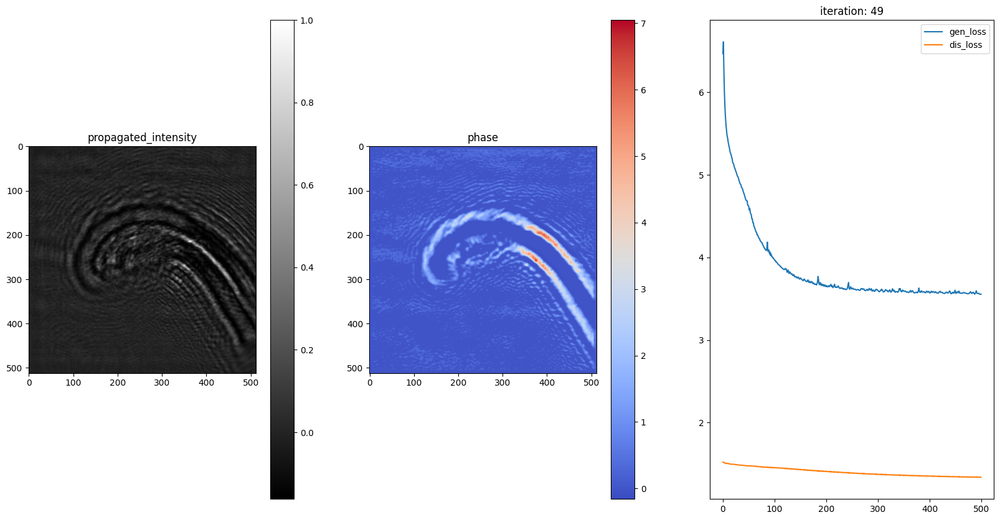

In [98]:
def live_plot(self):
    import matplotlib.pyplot as plt
    from IPython.display import clear_output
    for i in range(self.iter_num):
        clear_output(wait=True)
        plt.figure(figsize=(20,10))
        plt.subplot(1,3,3)
        plt.plot(tensor_to_np(self.gen_loss_list), label='gen_loss')
        plt.plot(tensor_to_np(self.dis_loss_list), label='dis_loss')
        plt.title('iteration: '+str(i))
        plt.legend()
        plt.subplot(1,3,1)
        plt.title('propagated_intensity')
        plt.imshow(tensor_to_np(self.propagated_intensity_list[i]), cmap='gray')
        plt.colorbar()
        plt.subplot(1,3,2)
        plt.title('phase')
        plt.imshow(tensor_to_np(self.phase_list[i]), cmap='coolwarm')
        plt.colorbar()
        plt.gca()
        plt.show()
live_plot(model)

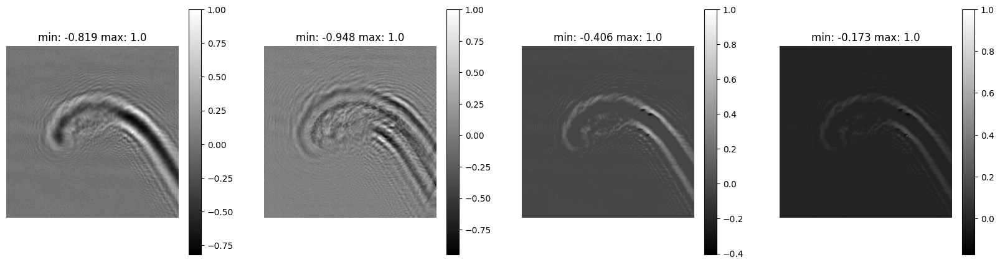

In [7]:
fig = visualize([tensor_to_np(dataloader.transformed_images), tensor_to_np(propagated_intensity_list[-1]), tensor_to_np(phase_list[-1]), tensor_to_np(attenuation_list[-1])])

# Difference between different padding mods

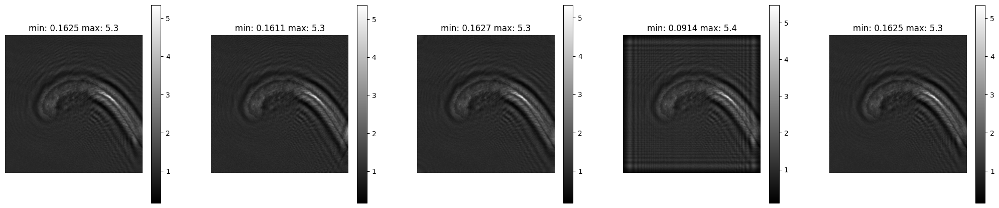

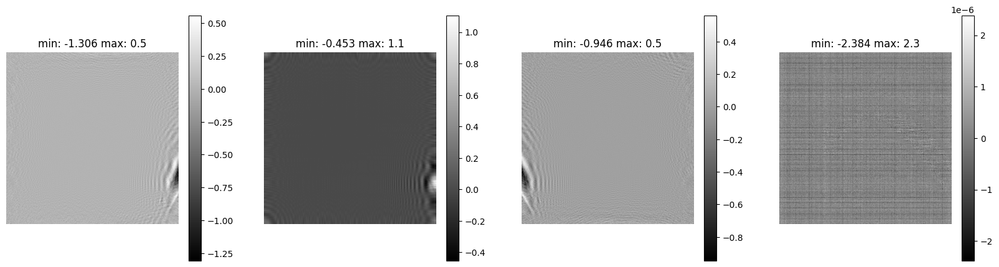

In [112]:
phase = torchnor_phase(dataloader.kwargs['image'][0])
absorption = phase
dataloader.kwargs.update({'idx': idx, 'iter_num':50, 'pad': 2, 'init_model': False, 'transform_type': 'norm', 'transform_factor': 0.5, 'file_type': 'tif'})
value = tensor_to_np(torch.mean(phase)).item()
cons_prop = forward_propagate(phase_image = phase, attenuation_image=absorption, mode = 'constant', value = value, **dataloader.kwargs)
ref_prop = forward_propagate(phase_image = phase, attenuation_image=absorption, mode = 'reflect', **dataloader.kwargs)
repli_prop = forward_propagate(phase_image = phase, attenuation_image=absorption, mode = 'replicate', **dataloader.kwargs)
cons_prop_1 = forward_propagate(phase_image = phase, attenuation_image=absorption, mode = 'constant', value = 1, **dataloader.kwargs)
cons_prop_0 = forward_propagate(phase_image = phase, attenuation_image=absorption, mode = 'constant', value = 0, **dataloader.kwargs)
circ_prop = forward_propagate(phase_image = phase, attenuation_image=absorption, mode = 'circular', **dataloader.kwargs)
visualize([tensor_to_np(cons_prop), tensor_to_np(ref_prop), tensor_to_np(repli_prop), tensor_to_np(cons_prop_1), tensor_to_np(cons_prop_0), tensor_to_np(circ_prop)])
diff = visualize([tensor_to_np(cons_prop) - tensor_to_np(ref_prop), tensor_to_np(repli_prop) - tensor_to_np(cons_prop), tensor_to_np(cons_prop) - tensor_to_np(circ_prop), tensor_to_np(cons_prop) - tensor_to_np(cons_prop_0)])

In [84]:
v = tensor_to_np(torch.mean(phase))
#extract scalar from 0 dimensional numpy array
v = v.item()

In [5]:


def make_generator(nfx, nfy, conv_num, conv_size, dropout, output_num, fresnel_factor, input_image = None, device = None, **kwargs):
    units = 128
    if input_image == None:
        input_image = torch.randn(1, 1, nfx, nfy)
    fc_size = nfx * nfy
    fc_stack = nn.ModuleList([
        dense_layer(in_features=units, out_features=units, dropout=dropout),
            dense_layer(in_features=units, out_features=units, dropout=dropout),
            dense_layer(in_features=units, out_features=units, dropout=dropout),
            dense_layer(in_features=units, out_features=units, dropout=dropout),
        ])
    conv_stack = nn.ModuleList([
        conv2d_layer(in_channels=1, out_channels=conv_num, kernel_size=conv_size+2, stride=1),
        conv2d_layer(in_channels=conv_num, out_channels=conv_num, kernel_size=conv_size, stride=1),
        conv2d_layer(in_channels=conv_num, out_channels=conv_num, kernel_size=conv_size, stride=1),
        conv2d_layer(in_channels=conv_num, out_channels=conv_num, kernel_size=conv_size, stride=1),
        ])
    dconv_stack = nn.ModuleList([
        deconv2d_layer(in_channels=conv_num, out_channels=conv_num, kernel_size=conv_size, stride=1),
        deconv2d_layer(in_channels=conv_num, out_channels=conv_num, kernel_size=conv_size+2, stride=1),
        deconv2d_layer(in_channels=conv_num, out_channels=conv_num, kernel_size=conv_size+2, stride=1),
        deconv2d_layer(in_channels=conv_num, out_channels=output_num, kernel_size=conv_size, stride=1),
        ])
    last_1 = conv2d_layer(in_channels=conv_num, out_channels=output_num, kernel_size=conv_size, stride=1)
    last = conv2d_layer(in_channels=output_num, out_channels=output_num, kernel_size=conv_size, stride=1)
    tanh_on_first_two = lambda x: torch.reshape(nn.Tanh()(x[:, :, :, :2]), [1, nfx, nfy, 2])
    relu_on_last = lambda x: torch.reshape(nn.ReLU()(x[:, :, :, 2]), [1, nfx, nfy, 1])
    only_layer = lambda x, i: torch.reshape(x[:, :, :, i], [1, nfx, nfy, 1])

    x = torch.flatten(input_image, start_dim=1).T
    if device is None:
        x = dense_layer(in_features=1, out_features=units, dropout=dropout)(x)
        for fc in fc_stack:
            init.kaiming_normal_(fc[0].weight)
            x = fc(x)
        x = dense_layer(in_features=units, out_features=1, dropout=0)(x)
        x = torch.reshape(x, shape=[1, 1, nfx, nfy])
        # Convolutions
        for conv in conv_stack:
            x = conv(x)
        for dconv in dconv_stack:
            x = dconv(x)
        if output_num > 2:
            x = last_1(x)
            x = [tanh_on_first_two(x), only_layer(x, 2)]
            phase = torch.atan2(x[0][0, :, :, 0], x[0][0, :, :, 1])
            phase = (torch.reshape(phase, [1, nfx, nfy, 1]))
            absorption = (torch.reshape((x[1][0, :, :, 0]), [1, nfx, nfy, 1]))
            x = torch.cat([phase, absorption], axis=3)
        x = last(x)
        return  x
    else:
        if str(x.device) == 'cpu':
            x = to_device(x, device)
        x = to_device(dense_layer(in_features=1, out_features=units, dropout=dropout), device)(x)
        for fc in fc_stack:
            init.kaiming_normal_(fc[0].weight)
            x = to_device(fc, device)(x)

        x = to_device(dense_layer(in_features=units, out_features=1, dropout=0), device)(x)
        x = torch.reshape(x, shape=[1, 1, nfx, nfy])
        # Convolutions
        for conv in conv_stack:
            x = to_device(conv, device)(x)
        for dconv in dconv_stack:
            x = to_device(dconv, device)(x)
        if output_num > 2:
            x = to_device(last_1, device)(x)
            x = [tanh_on_first_two(x), only_layer(x, 2)]
            phase = torch.atan2(x[0][0, :, :, 0], x[0][0, :, :, 1])
            phase = (torch.reshape(phase, [1, nfx, nfy, 1]))
            absorption = (torch.reshape((x[1][0, :, :, 0]), [1, nfx, nfy, 1]))
            x = torch.cat([phase, absorption], axis=3)
        x = to_device(last, device)(x)
        return  x

def make_discriminator(nfx, nfy, conv_num, conv_size, dropout, output_num, fresnel_factor, input_image = None,device = None, **kwargs):
    discriminator_stack = nn.ModuleList([
        conv2d_layer(in_channels=1, out_channels=16, kernel_size=5, stride=2),
        conv2d_layer(in_channels=16, out_channels=16, kernel_size=5, stride=1),
        conv2d_layer(in_channels=16, out_channels=32, kernel_size=5, stride=2),
        conv2d_layer(in_channels=32, out_channels=32, kernel_size=5, stride=1),
        conv2d_layer(in_channels=32, out_channels=64, kernel_size=3, stride=2),
        conv2d_layer(in_channels=64, out_channels=64, kernel_size=3, stride=1),
        conv2d_layer(in_channels=64, out_channels=64, kernel_size=3, stride=2),
        conv2d_layer(in_channels=64, out_channels=64, kernel_size=3, stride=1),
        nn.Flatten(),
        ])
    alpha = 1e-8
    if input_image == None:
        x = torch.randn(1, 1, nfx, nfy)
    else:
        x = input_image
    if device is None:
        for conv in discriminator_stack:
            x = conv(x)
        x = nn.Linear(x.shape[1], 1)(x)
        return x
    else:
        if str(x.device) == 'cpu':
            x = to_device(x, device)
        for conv in discriminator_stack:
            x = to_device(conv, device)(x)
        x = to_device(nn.Linear(x.shape[1], 1), device)(x)
        return x

class generator_discriminator(nn.Module):
    def __init__(self, nfx, nfy, conv_num, conv_size, dropout, output_num, fresnel_factor, device = None, **kwargs):
        super(generator_discriminator, self).__init__()

        if kwargs is not None:
            for key, value in kwargs.items():
                setattr(self, key, value)
        
        self.fresnel_factor = fresnel_factor
        self.device = device
        self.nfx = nfx
        self.nfy = nfy
        self.conv_num = conv_num
        self.conv_size = conv_size
        self.dropout = dropout
        self.output_num = output_num
        self.units = 128
        self.fc_size = nfx * nfy
        self.fc_stack = nn.ModuleList([
            dense_layer(in_features=self.units, out_features=self.units, dropout=self.dropout),
            dense_layer(in_features=self.units, out_features=self.units, dropout=self.dropout),
            dense_layer(in_features=self.units, out_features=self.units, dropout=self.dropout),
            dense_layer(in_features=self.units, out_features=self.units, dropout=self.dropout),
        ])
        self.conv_stack = nn.ModuleList([
            conv2d_layer(in_channels=1, out_channels=self.conv_num, kernel_size=self.conv_size+2, stride=1),
            conv2d_layer(in_channels=self.conv_num, out_channels=self.conv_num, kernel_size=self.conv_size, stride=1),
            conv2d_layer(in_channels=self.conv_num, out_channels=self.conv_num, kernel_size=self.conv_size, stride=1),
            conv2d_layer(in_channels=self.conv_num, out_channels=self.conv_num, kernel_size=self.conv_size, stride=1),
        ])
        self.dconv_stack = nn.ModuleList([
            deconv2d_layer(in_channels=self.conv_num, out_channels=self.conv_num, kernel_size=self.conv_size, stride=1),
            deconv2d_layer(in_channels=self.conv_num, out_channels=self.conv_num, kernel_size=self.conv_size+2, stride=1),
            deconv2d_layer(in_channels=self.conv_num, out_channels=self.conv_num, kernel_size=self.conv_size+2, stride=1),
            deconv2d_layer(in_channels=self.conv_num, out_channels=self.output_num, kernel_size=self.conv_size, stride=1),
            
        ])
        self.last_1 = conv2d_layer(in_channels=self.conv_num, out_channels=self.output_num, kernel_size=self.conv_size, stride=1)
        self.last = conv2d_layer(in_channels=self.output_num, out_channels=self.output_num, kernel_size=self.conv_size, stride=1)
        self.tanh_on_first_two = lambda x: torch.reshape(nn.Tanh()(x[:, :, :, :2]), [1, nfx, nfy, 2])
        self.relu_on_last = lambda x: torch.reshape(nn.ReLU()(x[:, :, :, 2]), [1, nfx, nfy, 1])
        self.only_layer = lambda x, i: torch.reshape(x[:, :, :, i], [1, nfx, nfy, 1])
        #use the make_discriminator function to make the discriminator
        self.discriminator_stack = nn.ModuleList([
            conv2d_layer(in_channels=1, out_channels=16, kernel_size=5, stride=2),
            conv2d_layer(in_channels=16, out_channels=16, kernel_size=5, stride=1),
            conv2d_layer(in_channels=16, out_channels=32, kernel_size=5, stride=2),
            conv2d_layer(in_channels=32, out_channels=32, kernel_size=5, stride=1),
            conv2d_layer(in_channels=32, out_channels=64, kernel_size=3, stride=2),
            conv2d_layer(in_channels=64, out_channels=64, kernel_size=3, stride=1),
            conv2d_layer(in_channels=64, out_channels=64, kernel_size=3, stride=2),
            conv2d_layer(in_channels=64, out_channels=64, kernel_size=3, stride=1),
            nn.Flatten(),
        ])
        self.alpha = 1e-8

    def make_ganrec_model(self, nfx, nfy, conv_num, conv_size, dropout, output_num, fresnel_factor, input_image = None, device = None, **kwargs):
        self.generator = make_generator(nfx, nfy, conv_num, conv_size, dropout, output_num, fresnel_factor, input_image, device = None, **kwargs)
        self.discriminator = make_discriminator(nfx, nfy, conv_num, conv_size, dropout, output_num, fresnel_factor, input_image, device = None, **kwargs)
        self.generator_optimizer = torch.optim.Adam(self.generator.parameters(), lr=1e-4)
        self.discriminator_optimizer = torch.optim.Adam(self.discriminator.parameters(), lr=1e-4)
        self.fresnel_factor = torch_reshape(self.fresnel_factor, complex=True)
        
    def forward_generator(self, x):
        x = make_generator(self.nfx, self.nfy, self.conv_num, self.conv_size, self.dropout, self.output_num, self.fresnel_factor, x, self.device)
        return x
    
    def forward_discriminator(self, x):
        x = make_discriminator(self.nfx, self.nfy, self.conv_num, self.conv_size, self.dropout, self.output_num, self.fresnel_factor, x, self.device)
        return x
    
    def make_model(self, x):
        self.x = x
        self.fg = self.forward_generator(x)
        self.fd = self.forward_discriminator(x)
        self.discriminator_optimizer = torch.optim.Adam(self.parameters(), lr=1e-4)
        self.generator_optimizer = torch.optim.Adam(self.parameters(), lr=1e-4)
        self.fresnel_factor = torch_reshape(self.fresnel_factor, complex=True)

    def propagate(self, x, fresnel_factor):
        """
        We propagate the output of the forward function to the detector plane using Fresnel propagation
        """
        phase = torchnor_phase(x[:,0,:,:])
        attenuation = (1 - torchnor_phase(x[:,1,:,:]) * 0.005)
        dtype = torch.complex64
        fresnel_factor.type(dtype)
        propagated_intensity = torchnor_phase(forward_propagate(shape_x = self.shape_x, shape_y = self.shape_y, pad = self.pad, energy_kev = self.energy_kev, detector_pixel_size = self.detector_pixel_size, distance_sample_detector = self.distance_sample_detector, phase_image = phase, attenuation_image = attenuation, fresnel_factor  = self.fresnel_factor, wavefield = None, distance =  self.distance_sample_detector))
        return propagated_intensity, phase, attenuation
    
    def train_step(self, x):
        self.make_model(x)
        g_loss = torch.Tensor([0]*self.iter_num)
        d_loss = torch.Tensor([0]*self.iter_num)
        propagations = self.iter_num * [None]
        phases = self.iter_num * [None]
        attenuations = self.iter_num * [None]
        # prop_int = torch.ones_like(self.iter_num, x)
        # prop_phase = torch.ones_like(self.iter_num, x)
        # prop_att = torch.ones_like(self.iter_num, x)
        for epoch in range(self.iter_num):
            self.generator_optimizer.zero_grad()
            self.discriminator_optimizer.zero_grad()
            
            with torch.autograd.set_detect_anomaly(True):
                pred = self.fg
                propagated_intensity, phase, attenuation = self.propagate(pred, self.fresnel_factor)

                real_output = self.fd
                fake_output = self.forward_discriminator(propagated_intensity.cpu())
                generator_loss_value = generator_loss(fake_output, x, propagated_intensity.cpu(), l1_ratio=10)
                discriminator_loss_value = discriminator_loss(real_output, fake_output)
                generator_loss_value.backward(retain_graph=True)
                discriminator_loss_value.backward(retain_graph=True)

                propagations[epoch] = propagated_intensity
                phases[epoch] = phase
                attenuations[epoch] = attenuation
                g_loss[epoch] = generator_loss_value
                d_loss[epoch] = discriminator_loss_value
                self.generator_optimizer.step()
                self.discriminator_optimizer.step()
                print('epoch: {}, generator loss: {}, discriminator loss: {}'.format(epoch, generator_loss_value, discriminator_loss_value))
        return propagations, phases, attenuations, generator_loss_value, discriminator_loss_value
    
    def size(self) -> int:
        return super().__sizeof__()
    
    def summary(self, input_size):
        "example: self.summary((1,128,128))"
        from torchsummary import summary
        overall = summary(self, input_size=input_size)
        return overall
    
    def viz_model(self, input_size, size_per_element, min_size, vis_generator = True):
        """example: self.viz_model((3,128,128))"""
        from torchviz import make_dot
        random_input = torch_reshape(torch.randn(input_size))
        if vis_generator:
            dot = make_dot(self.forward_generator(random_input), params=dict(list(self.named_parameters())))
        else:
            dot = make_dot(self.forward_discriminator(random_input), params=dict(list(self.named_parameters())))
        num_rows = len(dot.body)
        content_size = num_rows * size_per_element
        size = max(min_size, content_size)
        size_str = str(size) + "," + str(size)
        dot.graph_attr.update(size=size_str)
        return dot

class unet_Module(nn.Module):
    def __init__(self, in_channels, out_channels, kernel_size, stride, padding, depth, bias, batch_norm, activation, device = None, **kwargs):
        super(unet_Module, self).__init__()
        if kwargs is not None:
            for key, value in kwargs.items():
                setattr(self, key, value)
        self.depth = depth
        self.kernel_size = kernel_size
        self.stride = stride
        self.padding = padding
        self.bias = bias
        self.batch_norm = batch_norm
        self.activation = activation
        self.units = 128
        self.dropout = 0.25
        self.down_list = [2**(i+5) for i in range(depth)]
        self.up_list = [2**(4+depth-i) for i in range(depth)]
        self.in_channels = in_channels
        self.out_channels = out_channels
        self.down_list = [in_channels] + self.down_list
        self.up_list = self.up_list + [out_channels]

        self.fc_stack = nn.ModuleList([
            dense_layer(in_features=self.units, out_features=self.units, dropout=self.dropout),
            dense_layer(in_features=self.units, out_features=self.units, dropout=self.dropout),
            dense_layer(in_features=self.units, out_features=self.units, dropout=self.dropout),
            dense_layer(in_features=self.units, out_features=self.units, dropout=self.dropout),
        ])
        
        self.down_conv = nn.ModuleList([nn.Conv2d(self.down_list[i], self.down_list[i+1], kernel_size, stride, padding, bias=bias) for i in range(depth) if i < depth])
        self.up_conv = nn.ModuleList([nn.ConvTranspose2d(self.up_list[i], self.up_list[i+1], kernel_size, stride, padding, bias=bias) for i in range(depth)])
        self.down_bn = nn.ModuleList([nn.BatchNorm2d(self.down_list[i+1]) for i in range(depth)])
        self.up_bn = nn.ModuleList([nn.BatchNorm2d(self.up_list[i+1]) for i in range(depth)])
        self.concat_conv = nn.ModuleList([nn.ConvTranspose2d(self.up_list[i+1] + self.up_list[i], self.up_list[i+1], kernel_size, stride, padding, bias=bias) for i in range(depth-1)])
        self.downsample = nn.MaxPool2d(2, 2)
        self.upsample = nn.Upsample(scale_factor=2, mode='bilinear', align_corners=True)
        self.batch_norm = batch_norm
        if device is not None:
            self.device = device
        else:
            self.device = None
        
        self.alpha = 1e-8
    
    def forward(self, x):
        """
        *********************************************************************************************************************************************
            first stage: convolution: 1 -> 32 -> 64 | then downsampling 
            second stage: convolution: 64 -> 128 | then downsampling 128 -> 256 | 
            third stage: conv: 256 -> 512 | downsampling: 512 -> 1024 | 
            fourthstage: deconv: 1024 -> 512 | upsampling: 512 -> 256 | 
            thirdstage: combine previous thirdstage and deconv: 512+256 -> 128 | 
            second stage: combine with prev second stage and deconv:  256 + 128 -> 64 | 
            first stage: combine with prev first stage and deconv: 64 -> 32 | 32 -> 2   where 2 is the number of output channels   
        *********************************************************************************************************************************************     
        """
        self.input_size = x.detach().cpu().numpy().shape
        self.shape_x = self.input_size[2] if len(self.input_size) == 4 else self.input_size[0]
        self.shape_y = self.input_size[3] if len(self.input_size) == 4 else self.input_size[1]
        self.fc_size = self.shape_x * self.shape_y
        out = []
        x = torch.flatten(x, start_dim=1).T     
        x = dense_layer(in_features=1, out_features=self.units, dropout=self.dropout)(x)
        for fc in self.fc_stack:
            init.kaiming_normal_(fc[0].weight)
            x = fc(x)

        x = dense_layer(in_features=self.units, out_features=1, dropout=0)(x)

        x = torch.reshape(x, shape=[1, 1, self.shape_x, self.shape_y])
        x = self.down_conv[0](x)
        # x = nn.ReLU()(x)
        for i in range(1,self.depth):          
            x = self.down_conv[i](x)
            if self.batch_norm:
                x = self.down_bn[i](x)
            # x = nn.SiLU()(x)
            # x = nn.ReLU()(x)
            x = self.downsample(x)
            if i != self.depth-1:
                out.append(x)
        for i in range(self.depth - 1):
            x = self.up_conv[i](x)
            if i != 0:
                x = torch.cat([x, out[-i]], dim=1)
                x = self.concat_conv[i](x)
            x = self.upsample(x)
            # x = nn.SiLU()(x)
            if self.batch_norm:
                x = self.up_bn[i](x)
            # x = nn.ReLU()(x)
            # x = nn.SiLU()(x)
        x = self.up_conv[self.depth-1](x)
        self.out = x
        return x
    
    def propagate(self, x, fresnel_factor):
        """
        We propagate the output of the forward function to the detector plane using Fresnel propagation
        """
        
        out = self.forward(x)
        phase = torchnor_phase(out[:,0,:,:])
        attenuation = (1 - torchnor_phase(out[:,1,:,:]) * 0.005)
        dtype = torch.complex64
        wave = torch.exp(1j * phase - attenuation).type(dtype)
        propagated_intensity = torchnor_phase(forward_propagate(shape_x = self.shape_x, shape_y = self.shape_y, pad = self.pad, energy_kev = self.energy_kev, detector_pixel_size = self.detector_pixel_size, distance_sample_detector = self.distance_sample_detector, phase_image = phase, attenuation_image = attenuation, fresnel_factor  = self.fresnel_factor, wavefield = None, distance =  self.distance_sample_detector))
        return propagated_intensity, phase, attenuation

    def size(self) -> int:
        return super().__sizeof__()
    
    def summary(self, input_size):
        "example: self.summary((1,128,128))"
        from torchsummary import summary
        overall = summary(self, input_size=input_size)
        return overall
    def viz_model(self, input_size, size_per_element, min_size):
        """example: self.viz_model((3,128,128))"""
        from torchviz import make_dot
        random_input = torch_reshape(torch.randn(input_size))
        dot = make_dot(self(random_input), params=dict(list(self.named_parameters())))
        num_rows = len(dot.body)
        content_size = num_rows * size_per_element
        size = max(min_size, content_size)
        size_str = str(size) + "," + str(size)
        dot.graph_attr.update(size=size_str)
        return dot
    
    # def train(self, ff, epochs, dataloader, optimizer, loss_function):
    #     for epoch in range(epochs):
    #         intensity, phase, attenuation = self.propagate(dataloader.transformed_images, ff)
    #         loss = loss_function(intensity, dataloader.images)
    #         optimizer.zero_grad()
    #         loss.backward()
    #         optimizer.step()
    #         print('epoch: {}, loss: {}'.format(epoch, loss))
    #     return intensity, phase, attenuation

dataloader = Ganrec_Dataloader(**dataloader.kwargs)
# make_generator(**dataloader.kwargs)
# make_discriminator(**dataloader.kwargs)

model = generator_discriminator(**dataloader.kwargs)

if model.device is not None:
    model.to(model.device)
    dataloader.transformed_images = dataloader.transformed_images.to(model.device)
    model.fresnel_factor = torch_reshape(model.fresnel_factor, complex = True).to(model.device)
    model.transformed_images = dataloader.transformed_images.to(model.device)




49017

In [9]:

g_loss = torch.Tensor([0]*model.iter_num)
d_loss = torch.Tensor([0]*model.iter_num)
propagations = model.iter_num * [None]
phases = model.iter_num * [None]
attenuations = model.iter_num * [None]

optimizer = torch.optim.Adam(model.parameters(), lr=1e-4)
criterion = nn.Sequential(nn.MSELoss(), nn.L1Loss(), nn.SmoothL1Loss(), nn.BCELoss())



for epoch in range(model.iter_num):
    optimizer.zero_grad()
    with torch.autograd.set_detect_anomaly(True):
        pred = model.forward_generator(model.transformed_images)
        propagated_intensity, phase, attenuation = model.propagate(pred, model.fresnel_factor)

        real_output = model.forward_discriminator(dataloader.transformed_images)
        fake_output = model.forward_discriminator(propagated_intensity)
        generator_loss_value = generator_loss(fake_output, dataloader.transformed_images, propagated_intensity, l1_ratio=10)
        discriminator_loss_value = discriminator_loss(real_output, fake_output)
        
        propagations[epoch] = propagated_intensity.cpu()
        phases[epoch] = phase.cpu()
        attenuations[epoch] = attenuation.cpu()
        g_loss[epoch] = generator_loss_value.cpu()
        d_loss[epoch] = discriminator_loss_value.cpu()

        generator_loss_value.backward(retain_graph=True)
        discriminator_loss_value.backward(retain_graph=True)
        optimizer.step()
        print('epoch: {}, generator loss: {}, discriminator loss: {}'.format(epoch, generator_loss_value, discriminator_loss_value))
        #clear memory
        del pred
        del propagated_intensity
        del phase
        del attenuation
        del real_output
        del fake_output
        del generator_loss_value
        del discriminator_loss_value
        torch.cuda.empty_cache()
        


        
    

epoch: 0, generator loss: 2.3319437503814697, discriminator loss: 1.264338731765747
epoch: 1, generator loss: 2.8405189514160156, discriminator loss: 0.8723130226135254
epoch: 2, generator loss: 2.5241575241088867, discriminator loss: 1.2272415161132812
epoch: 3, generator loss: 3.185950756072998, discriminator loss: 0.9934501051902771
epoch: 4, generator loss: 2.4296212196350098, discriminator loss: 1.738351821899414
epoch: 5, generator loss: 2.8148317337036133, discriminator loss: 1.2737202644348145
epoch: 6, generator loss: 2.2343688011169434, discriminator loss: 1.416347622871399
epoch: 7, generator loss: 2.702669143676758, discriminator loss: 1.3494369983673096
epoch: 8, generator loss: 2.663849353790283, discriminator loss: 1.197540283203125
epoch: 9, generator loss: 2.4462995529174805, discriminator loss: 1.244639277458191


RuntimeError: CUDA out of memory. Tried to allocate 128.00 MiB (GPU 0; 31.74 GiB total capacity; 28.79 GiB already allocated; 100.12 MiB free; 28.87 GiB reserved in total by PyTorch) If reserved memory is >> allocated memory try setting max_split_size_mb to avoid fragmentation.  See documentation for Memory Management and PYTORCH_CUDA_ALLOC_CONF

In [16]:
gc.garbage

[]

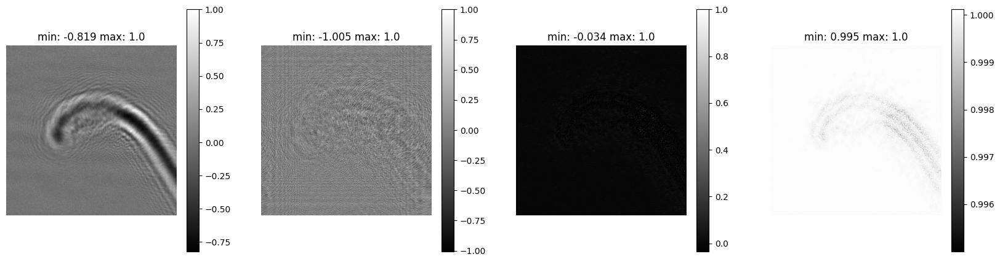

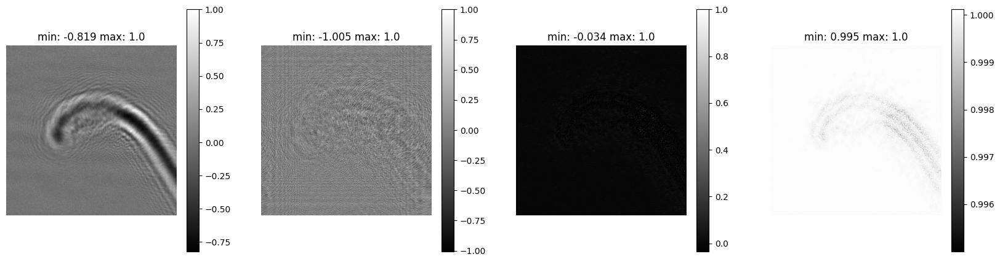

In [14]:
# plt.plot(tensor_to_np(generator_loss_value))
visualize([tensor_to_np(dataloader.transformed_images), tensor_to_np(propagations[8]), tensor_to_np(phases[8]), tensor_to_np(attenuations[8])])

In [16]:
idx = 2
dataloader.kwargs.update({'idx': idx})
dataloader = Ganrec_Dataloader(**dataloader.kwargs)
device = None
model = unet_Module(1, 2, 3, 1, 1, 6, False, True, True, device=device, **dataloader.kwargs)
# model.viz_model((1, 128, 128), 0.05, 0.1)
# model.summary((1, 256, 256))

In [17]:
fresnel_factor = torch.reshape(torch.from_numpy(dataloader.kwargs['fresnel_factor']), (1,1,dataloader.kwargs['fresnel_factor'].shape[0],dataloader.kwargs['fresnel_factor'].shape[1])).type(torch.complex64)
if device is not None:
    model.to(device)
    dataloader.transformed_images = dataloader.transformed_images.to(device)
    fresnel_factor.to(device)

epoch:  0 loss:  tensor(0.1201, grad_fn=<MeanBackward0>)
epoch:  1 loss:  tensor(0.0982, grad_fn=<MeanBackward0>)
epoch:  2 loss:  tensor(0.0945, grad_fn=<MeanBackward0>)
epoch:  3 loss:  tensor(0.1022, grad_fn=<MeanBackward0>)
epoch:  4 loss:  tensor(0.0993, grad_fn=<MeanBackward0>)
epoch:  5 loss:  tensor(0.1062, grad_fn=<MeanBackward0>)
epoch:  6 loss:  tensor(0.0982, grad_fn=<MeanBackward0>)
epoch:  7 loss:  tensor(0.0920, grad_fn=<MeanBackward0>)
epoch:  8 loss:  tensor(0.0981, grad_fn=<MeanBackward0>)
epoch:  9 loss:  tensor(0.0881, grad_fn=<MeanBackward0>)
epoch:  10 loss:  tensor(0.0894, grad_fn=<MeanBackward0>)
epoch:  11 loss:  tensor(0.0960, grad_fn=<MeanBackward0>)
epoch:  12 loss:  tensor(0.0910, grad_fn=<MeanBackward0>)
epoch:  13 loss:  tensor(0.0893, grad_fn=<MeanBackward0>)
epoch:  14 loss:  tensor(0.0884, grad_fn=<MeanBackward0>)
epoch:  15 loss:  tensor(0.0970, grad_fn=<MeanBackward0>)
epoch:  16 loss:  tensor(0.0867, grad_fn=<MeanBackward0>)
epoch:  17 loss:  tensor

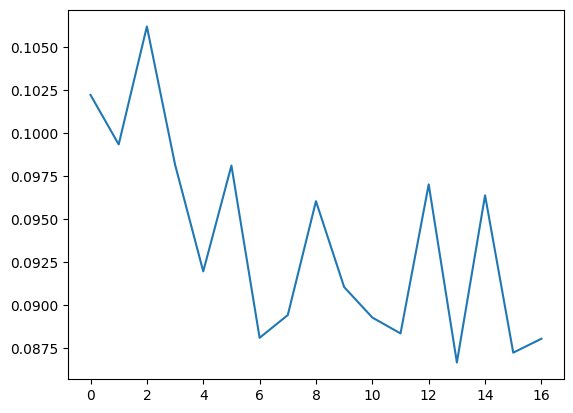

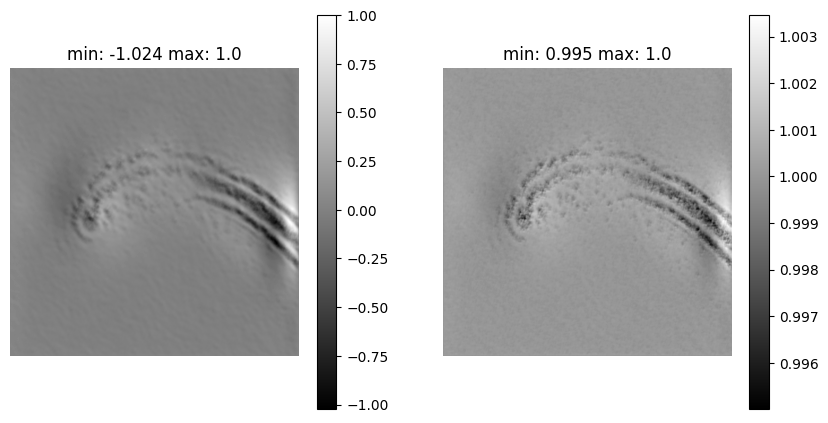

In [18]:
epochs = 20
generated_intensity = epochs * [None]
generated_phase = epochs * [None]
generated_attenuation = epochs * [None]
losses = epochs * [None]

optimizer = torch.optim.Adam(model.parameters(), lr=0.001)

for epoch in range(epochs):
    optimizer.zero_grad()
    intensity, phase, attenuation = model.propagate(dataloader.transformed_images, fresnel_factor)
    error = tik_reg(intensity, dataloader.transformed_images) #+ model.alpha * torch.mean(torch.abs(phase)) + model.alpha * torch.mean(torch.abs(attenuation))
    losses[epoch] = error
    print('epoch: ', epoch, 'loss: ', error)
    generated_intensity[epoch] = intensity
    generated_phase[epoch] = phase
    generated_attenuation[epoch] = attenuation
    error.backward()
    optimizer.step()
    
plt.plot(tensor_to_np(losses[3:]))
fig = visualize([tensor_to_np(generated_phase)[-1], tensor_to_np(generated_attenuation)[-1]], show_or_plot='show', )

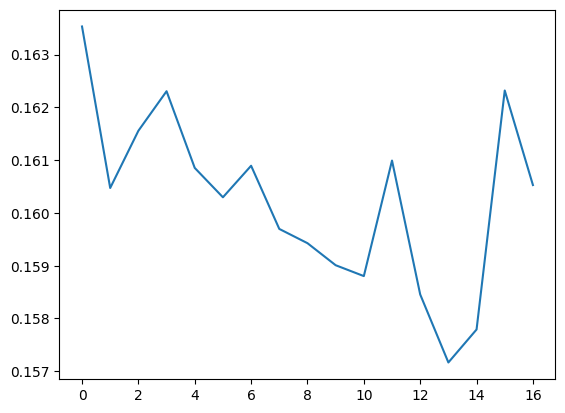

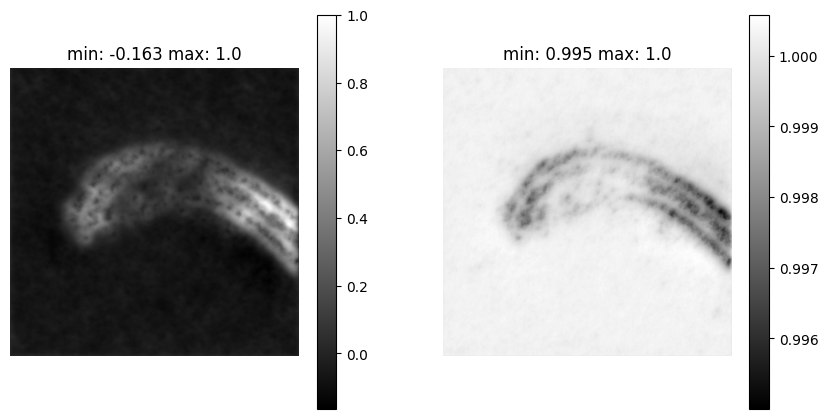

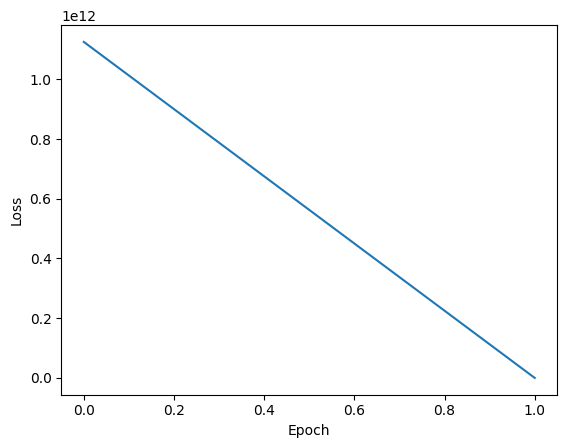

In [21]:
def plot_loss(losses):
    plt.figure()
    plt.plot(losses)
    plt.xlabel('Epoch')
    plt.ylabel('Loss')
    plt.show()
plot_loss(tensor_to_np(losses))

# visualize(generated_intensity[0][0,0,:,:].cpu().detach().numpy(), show_or_plot='show')

In [3]:
args["path"] = '/asap3/petra3/gpfs/p05/2023/data/11016663/raw/thomas_002_d150/tiff0003'
dataset = Ganrec_Dataloader(**args)

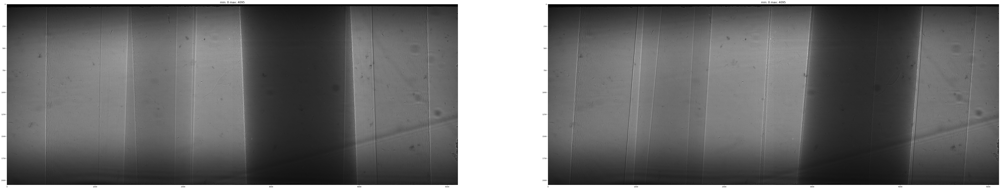

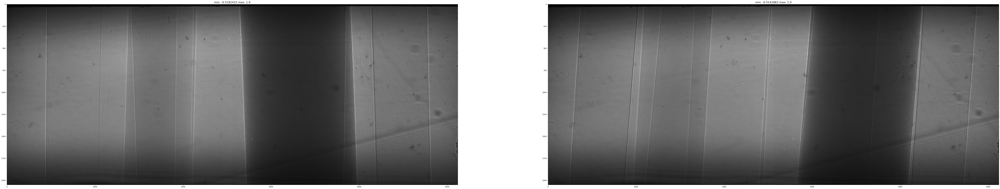

In [5]:
dataset.visualize()
dataset.normal_visualize()

In [6]:
dataset.image_path

['/asap3/petra3/gpfs/p05/2023/data/11016663/raw/thomas_002_d150/tiff0003/thomas_002_d150_0003542_img.tif',
 '/asap3/petra3/gpfs/p05/2023/data/11016663/raw/thomas_002_d150/tiff0003/thomas_002_d150_0003875_img.tif']

[3174, 860]

'dimensions of the dataset is (1, 1015, 2560)'

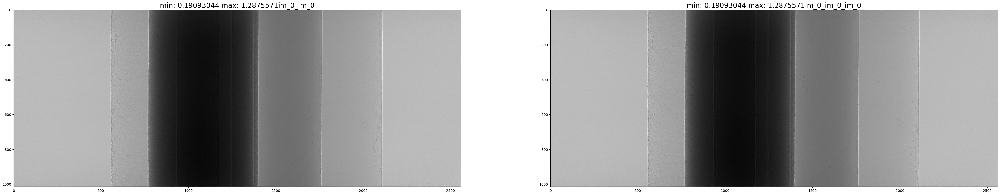

In [33]:
#create a dataloader
import torch


In [34]:
dataset.dims

(1, 1015, 2560)

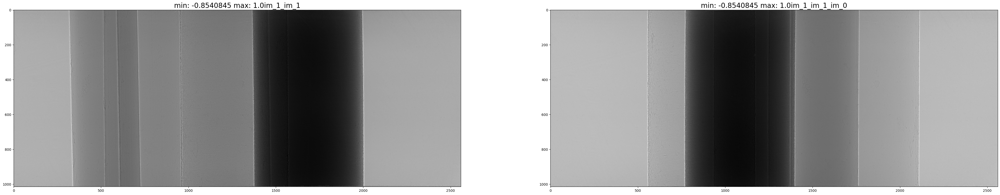

In [35]:
dataset.normal_visualize(idx, random=True)

In [36]:
dataset.tranformed_images.shape

torch.Size([2, 1, 1015, 2560])